In [1]:
import numpy as np
import scipy.signal as sig
import soundfile as sf
from matplotlib import pyplot as plt
import IPython.display as ipd

from mr import mysteryReverb

In [4]:
from IPython.display import Audio

Question 1: linear and exponential sweeps

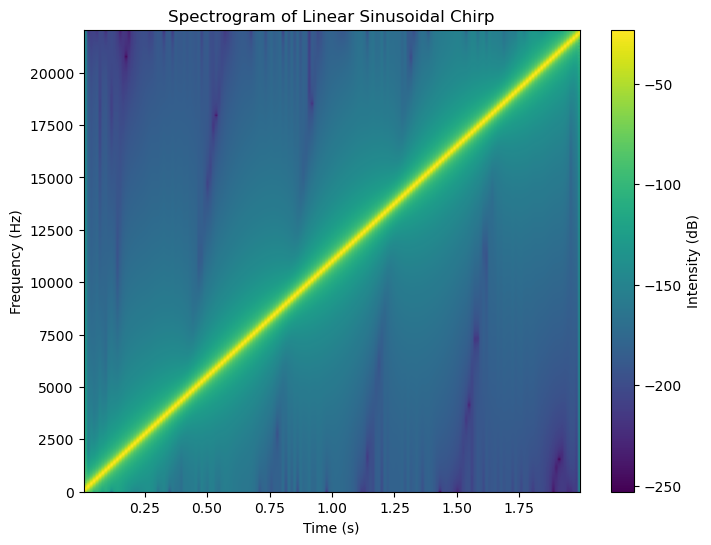

In [105]:
def linChirp(f0, f1, T, fs):
    '''
    outputs a chip that goes from frequency f0 to frequency f1 in T seconds
    covering a constant bandwith across time with samplerate fs
    '''
    t = np.arange(0,T,1.0/fs)
    omega0 = 2 * np.pi * f0
    omega1 = 2 * np.pi * f1
    k = (omega1 - omega0) / T
    s = np.sin(0.5 * k * t**2 + omega0 * t)
    
    
    fade_duration = 0.01 
    fade_samples = int(fs * fade_duration)
    fade = np.linspace(0, 1, fade_samples)
    s[:fade_samples] *= fade
    s[-fade_samples:] *= fade[::-1]
    return s
def plot_spectrogram(s, fs):
    plt.figure(figsize=(8, 6))
    plt.specgram(s, Fs=fs, NFFT=1024, noverlap=512, cmap='viridis')
    plt.colorbar(label='Intensity (dB)')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.title('Spectrogram of Linear Sinusoidal Chirp')
    plt.ylim(0, fs / 2)  
    plt.show()


f0 = 0  
f1 = 22050 
T = 2  
fs = 44100 
chirp = linChirp(f0, f1, T, fs)

plot_spectrogram(chirp, fs)


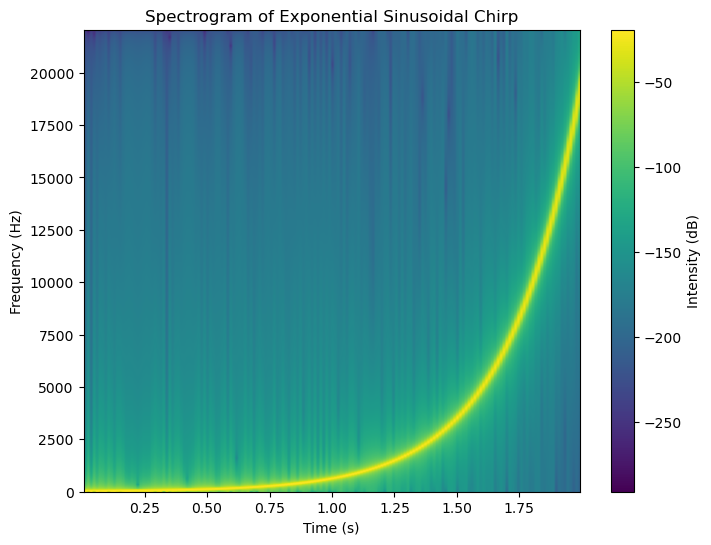

In [106]:
def logChirp(f0, f1, T, fs):
    '''
    outputs a chip that goes from frequency f0 to frequency f1 in T seconds
    with an exponential trajectory and with samplerate fs
    '''
    t = np.arange(0, T, 1.0/fs)
    k = np.log(f1/f0) / T
    s = np.sin(2 * np.pi * f0 * (np.exp(k * t) - 1) / k)

    return s

def plot_spectrogram(s, fs):
    plt.figure(figsize=(8, 6))
    plt.specgram(s, Fs=fs, NFFT=1024, noverlap=512, cmap='viridis')
    plt.colorbar(label='Intensity (dB)')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.title('Spectrogram of Exponential Sinusoidal Chirp')
    plt.ylim(0, fs / 2) 
    plt.show()


f0 = 20  
f1 = 20000  
T = 2
fs = 44100 
chirp = logChirp(f0, f1, T, fs)

plot_spectrogram(chirp, fs)

In [107]:
Audio(chirp, rate = 44100)

Question 2: mystery reverberation

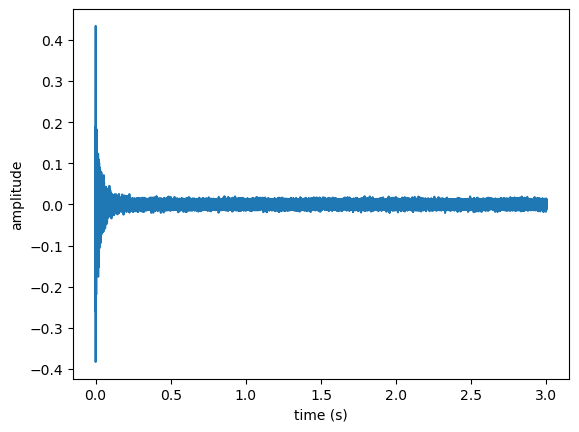

In [122]:
# example showing how to call the mysterReverb function with a dirac delta function
#2a
fs = 44100
x = np.zeros(3*fs)
x[0] = 1.

y = mysteryReverb(x)
plt.figure()
plt.plot(np.arange(0,np.size(y))/fs, y)
plt.xlabel('time (s)')
plt.ylabel('amplitude')
plt.show()

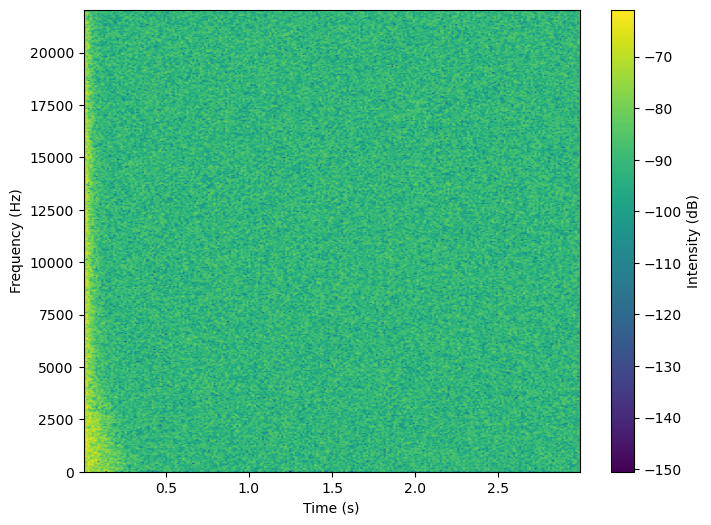

In [123]:
plt.figure(figsize=(8, 6))
plt.specgram(y, Fs=fs, NFFT=1024, noverlap=512)
plt.colorbar(label='Intensity (dB)')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.ylim(0, fs / 2)  
plt.show()

In [109]:
def snr_calculator(rir, threshold):
    """
    Calculate Signal-to-Noise Ratio (SNR) of a Room Impulse Response (RIR) measurement.
    
    Parameters:
    rir (array-like): The RIR measurement.
    
    Returns:
    float: SNR in dB.
    """
    peak = np.max(np.abs(rir))
    noise_floor = np.mean(np.abs(rir[int(len(rir)*threshold):])) 
    snr = 10 * np.log10((peak**2) / (noise_floor**2))
    
    return snr

#calculate the rms of the noise part of the signal to find the snr threshold 

In [110]:
def average_response(num_measurements):
    measurements = []
    for i in range(num_measurements):
        fs = 44100
        x = np.zeros(3*fs)
        x[0] = 1.
        y = mysteryReverb(x)
        measurements.append(y)
    return np.mean(measurements, axis=0)

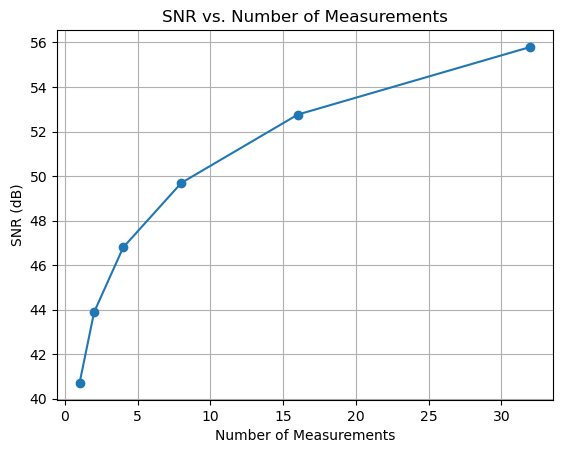

In [111]:
#2b
num_measurements_list = [2**n for n in range(6)]
snr_values = []

for num_measurements in num_measurements_list:
    avg_response = average_response(num_measurements)
    snr = snr_calculator(avg_response, 0.6)
    snr_values.append(snr)

plt.figure()
plt.plot(num_measurements_list, snr_values, marker='o')
plt.xlabel('Number of Measurements')
plt.ylabel('SNR (dB)')
plt.title('SNR vs. Number of Measurements')
plt.grid(True)
plt.show()

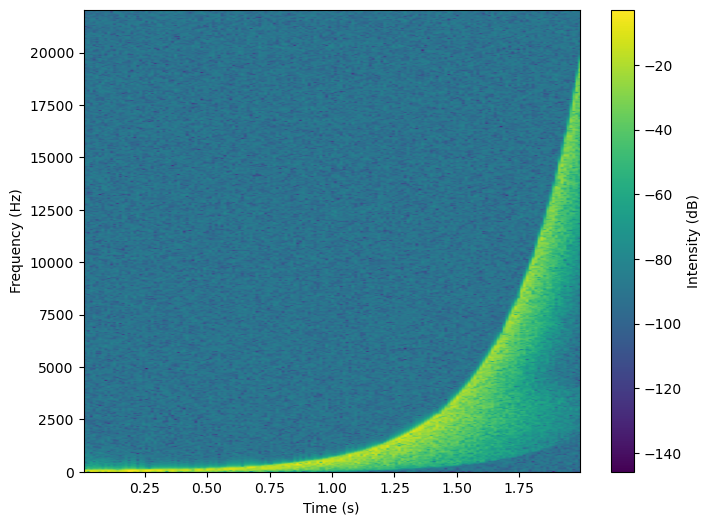

In [112]:
#2c
y = mysteryReverb(chirp)
plt.figure(figsize=(8, 6))
plt.specgram(y, Fs=fs, NFFT=1024, noverlap=512, cmap='viridis')
plt.colorbar(label='Intensity (dB)')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.ylim(0, fs / 2)  
plt.show()

In [113]:
from IPython.display import Audio
Audio(y, rate = 44100)

In [114]:
#2d
from numpy.fft import fft
from numpy.fft import ifft
rir_sweep = np.real(np.fft.ifft(np.fft.fft(y)/np.fft.fft(chirp)))

In [115]:
Audio(rir_sweep, rate = 44100)

In [116]:
snr_calculator(rir_sweep, 0.9)

56.34615252840319

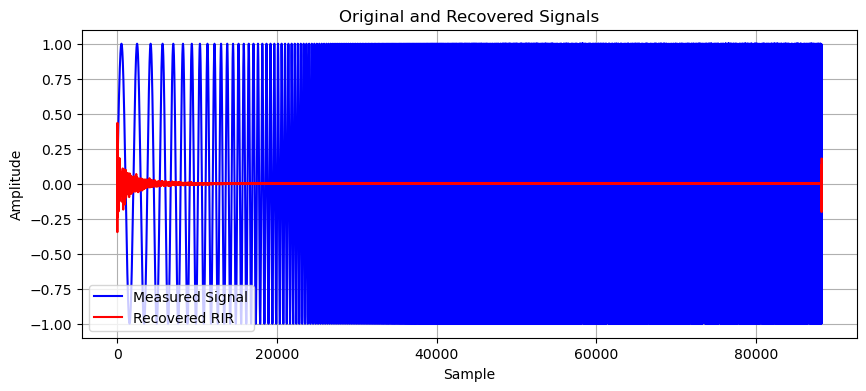

In [117]:
plt.figure(figsize=(10, 4))
plt.plot(chirp, label='Measured Signal', color='blue')
plt.plot(rir_sweep, label='Recovered RIR', color='red')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.title('Original and Recovered Signals')
plt.legend()
plt.grid(True)
plt.show()

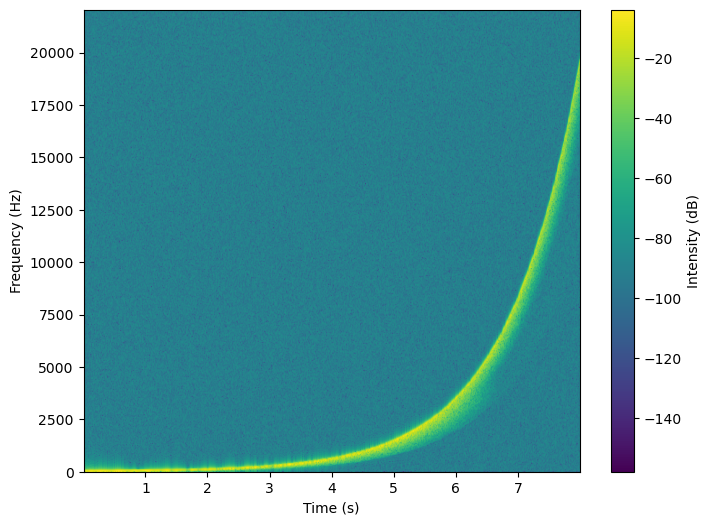

In [118]:
#2e
T = 8
eightsec_chirp = logChirp(f0, f1, T, fs)
y = mysteryReverb(eightsec_chirp)
plt.figure(figsize=(8, 6))
plt.specgram(y, Fs=fs, NFFT=1024, noverlap=512, cmap='viridis')
plt.colorbar(label='Intensity (dB)')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.ylim(0, fs / 2)  # Limit the y-axis to Nyquist frequency
plt.show()

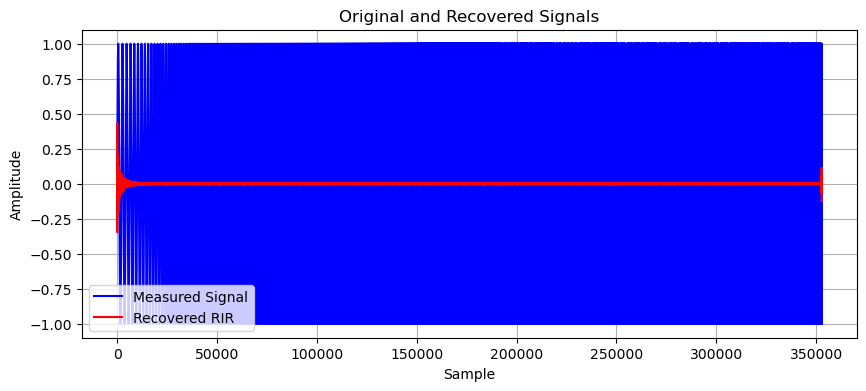

In [119]:
rir_sweep_8sec = np.real(np.fft.ifft(np.fft.fft(y)/np.fft.fft(eightsec_chirp)))
plt.figure(figsize=(10, 4))
plt.plot(eightsec_chirp, label='Measured Signal', color='blue')
plt.plot(rir_sweep_8sec, label='Recovered RIR', color='red')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.title('Original and Recovered Signals')
plt.legend()
plt.grid(True)
plt.show()

In [120]:
Audio(rir_sweep_8sec, rate = 44100)

In [121]:
snr_calculator(rir_sweep_8sec, 0.9)

50.85856215017561

In [126]:
#2f
convolved_toms_diner = np.convolve(toms_diner, rir_sweep, mode = 'full')
Audio(convolved_toms_diner, rate = 44100)

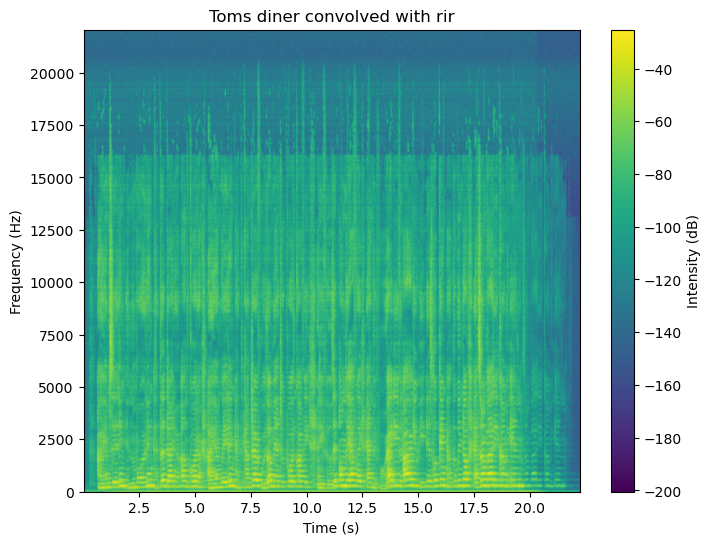

In [129]:
plt.figure(figsize=(8, 6))
plt.specgram(convolved_toms_diner, Fs=fs, NFFT=1024, noverlap=512, cmap='viridis')
plt.colorbar(label='Intensity (dB)')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.title('Toms diner convolved with rir')
plt.ylim(0, fs / 2)  
plt.show()

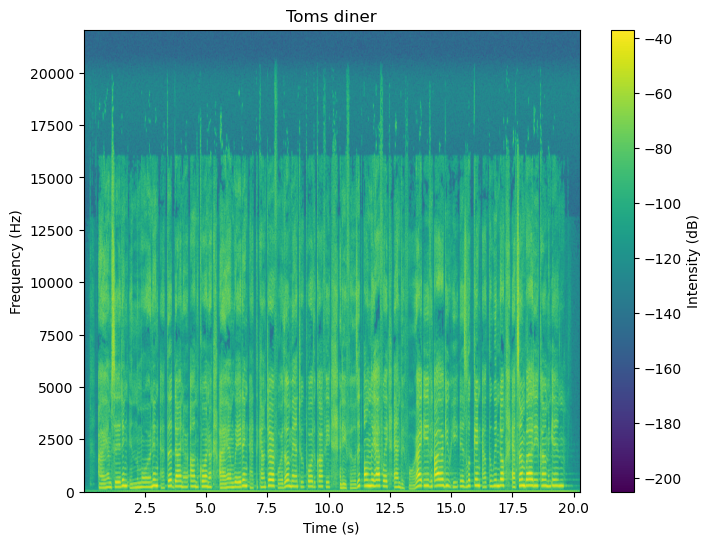

In [130]:
plt.figure(figsize=(8, 6))
plt.specgram(toms_diner, Fs=fs, NFFT=1024, noverlap=512, cmap='viridis')
plt.colorbar(label='Intensity (dB)')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.title('Toms diner')
plt.ylim(0, fs / 2)  
plt.show()

Question 3: Paulson Center reverberation analysis

In [2]:
#3a
probe_chirp, fs_probe = sf.read(r"C:\Users\Devyani Hebbar\Downloads\MPATE2607_hw4\MPATE2607_hw4\audio\logchirp_6s_20hz2nyquist_44100.wav")
measured_response, fs_response = sf.read(r"C:\Users\Devyani Hebbar\Downloads\MPATE2607_hw4\MPATE2607_hw4\audio\chirp_response.wav")

In [5]:
Audio(measured_response, rate = 44100)

In [63]:
paulson_rir = np.real(np.fft.ifft(np.fft.fft(measured_response, n = 529200)/np.fft.fft(probe_chirp, n =529200), n=529200))

In [7]:
print(len(measured_response)), print(len(probe_chirp))

381689
264600


(None, None)

In [55]:
Audio(paulson_rir, rate = 44100)

In [66]:
b,a = sig.butter(3, 2*100/fs, btype='high')
paulson_rir = sig.lfilter(b,a,paulson_rir)

In [26]:
test = np.convolve(paulson_rir, probe_chirp)
Audio(test, rate = 44100)

In [124]:
snr_calculator(paulson_rir, 0.6)

92.42780458873685

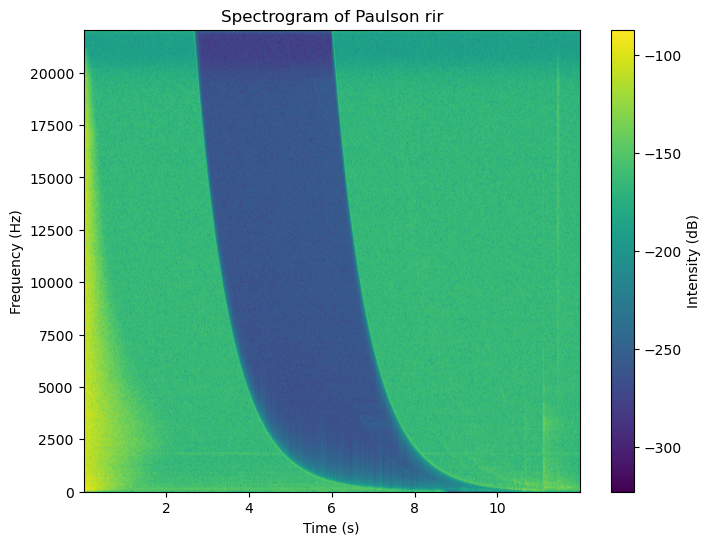

In [131]:
plt.figure(figsize=(8, 6))
plt.specgram(paulson_rir, Fs=fs, NFFT=1024, noverlap=512)
plt.colorbar(label='Intensity (dB)')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.title('Spectrogram of Paulson rir')
plt.ylim(0, fs / 2)  
plt.show()

In [40]:
#3b
convolved_signal = np.convolve(paulson_rir, toms_diner, mode = 'full')
Audio(convolved_signal, rate = 44100)

#Tom's diner when convolved with the Paulson RIR sounds more "echoey" than when the mystery reverb is applied to it.
#The reverberation time seems to be higher when it is convolved with the Paulson RIR as compared to the mystery reverb. 

In [44]:
#2c
balloon_pop, fs_balloonpop = sf.read(r"C:\Users\Devyani Hebbar\Downloads\MPATE2607_hw4\MPATE2607_hw4\audio\balloon_1.wav")
balloon_pop = sig.lfilter(b,a,balloon_pop)
toms_diner, fs_tomsdiner = sf.read(r"C:\Users\Devyani Hebbar\Downloads\MPATE2607_hw4\MPATE2607_hw4\audio\tomsDiner.wav")

In [45]:
Audio(toms_diner, rate = 44100)

In [46]:
convolved_signal = np.convolve(balloon_pop, toms_diner, mode = 'full')
Audio(convolved_signal, rate = 44100)

In [132]:
snr_calculator(balloon_pop, 0.6)

74.31630784046436

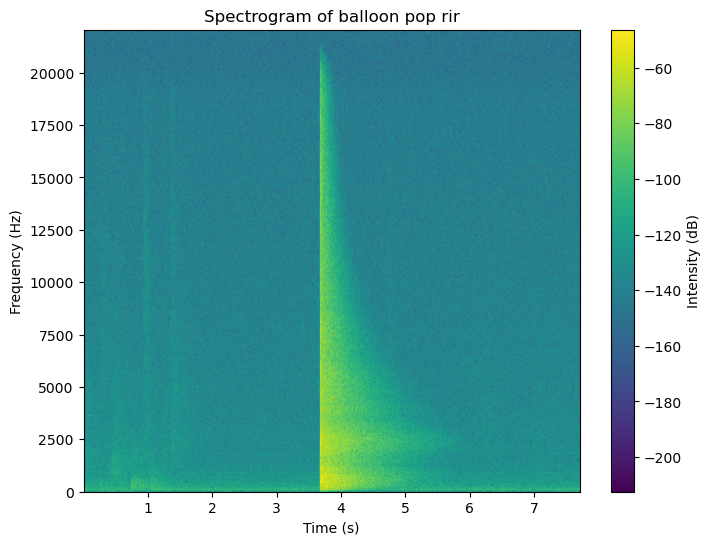

In [133]:
plt.figure(figsize=(8, 6))
plt.specgram(balloon_pop, Fs=fs, NFFT=1024, noverlap=512)
plt.colorbar(label='Intensity (dB)')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.title('Spectrogram of balloon pop rir')
plt.ylim(0, fs / 2)  
plt.show()

In [101]:
#2d
flipped_rir = (np.flip(paulson_rir))**2
integrated_rir = np.cumsum(flipped_rir)
double_flipped = np.flip(integrated_rir)
schroeder_curve = double_flipped/np.max(double_flipped)
schroeder_curve = 10 * np.log10(schroeder_curve)

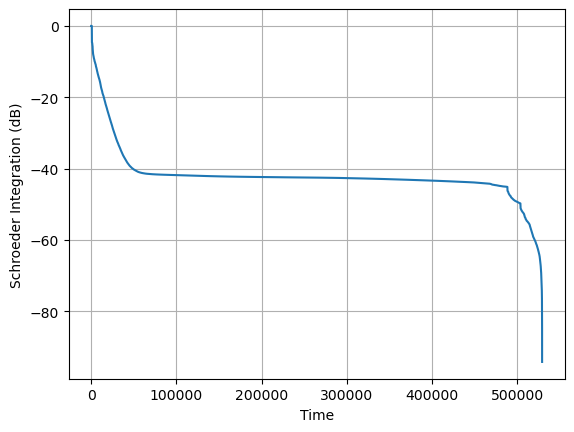

In [102]:
plt.plot(schroeder_curve)
plt.xlabel('Time')
plt.ylabel('Schroeder Integration (dB)')
plt.grid(True)
plt.show()

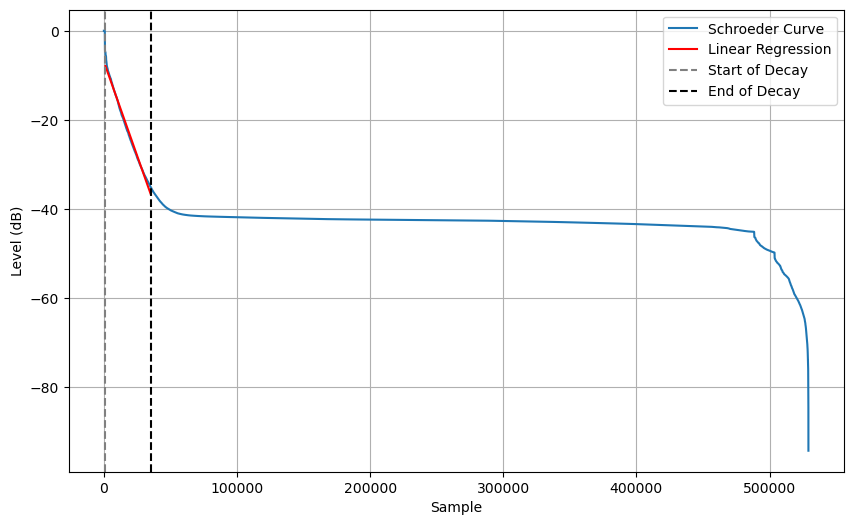

Reverberation Time (RT60): 1.61 seconds


In [103]:
from scipy.stats import linregress

start_decay = np.where(schroeder_curve <= -5)[0][0] 
end_decay = np.where(schroeder_curve <= -35)[0][0]

# Perform linear regression on the decay portion
x = np.arange(start_decay, end_decay)
y = schroeder_curve[start_decay:end_decay]
slope, intercept, r_value, p_value, std_err = linregress(x, y)

# Calculate RT60 using the slope (time it takes to drop 60 dB)
rt60 = abs(60 / slope) / fs


plt.figure(figsize=(10, 6))
plt.plot(schroeder_curve, label="Schroeder Curve")
plt.plot(x, slope * x + intercept, label="Linear Regression", color='red')
plt.axvline(x=start_decay, color='grey', linestyle='--', label='Start of Decay')
plt.axvline(x=end_decay, color='black', linestyle='--', label='End of Decay')
plt.xlabel("Sample")
plt.ylabel("Level (dB)")
plt.legend()
plt.grid(True)
plt.show()

print(f"Reverberation Time (RT60): {rt60:.2f} seconds")

In [87]:
# Center frequencies spaced by octaves
fcs = 62.5 * 2**np.arange(0, 8)

# output of filter bank
outputOfFilterbank = np.zeros((np.size(fcs), np.size(paulson_rir)))

# iterate over the center frequencies
for i in np.arange(0, np.size(fcs)):
    # for the first band, design lowpass filter
    if i == 0:
        b, a = sig.butter(2, fcs[i] * np.sqrt(2) / (fs / 2), btype='lowpass')
    # for the last band, design highpass filter
    elif i == len(fcs) - 1:
        b, a = sig.butter(2, fcs[i] / np.sqrt(2) / (fs / 2), btype='highpass')
    # for all the middle bands, design bandpass filters
    else:
        b, a = sig.butter(2, np.array([fcs[i] / np.sqrt(2), fcs[i] * np.sqrt(2)]) / (fs / 2), btype='bandpass')
    outputOfFilterbank[i,] = sig.filtfilt(b, a, paulson_rir)

# Calculate Schroeder curves and perform linear regression
RT60 = np.zeros(np.size(fcs))

for i in range(np.size(fcs)):
    squared_ir = outputOfFilterbank[i]**2
    rev_cum_sum = np.cumsum(squared_ir[::-1])[::-1]
    schroeder_curve = 10 * np.log10(rev_cum_sum)
    time_axis = np.arange(len(schroeder_curve)) / fs

    linear_region_index = int(0.02 * fs)  
    time_for_regression = time_axis[linear_region_index:]
    schroeder_curve_for_regression = schroeder_curve[linear_region_index:]

    slope, intercept, _, _, _ = linregress(time_for_regression, schroeder_curve_for_regression)
    RT60[i] = -60 / slope

for i, fc in enumerate(fcs):
    print(f"Reverberation Time in {fc:.2f} Hz band: {RT60[i]:.2f} seconds")


Reverberation Time in 62.50 Hz band: 42.61 seconds
Reverberation Time in 125.00 Hz band: 50.79 seconds
Reverberation Time in 250.00 Hz band: 62.09 seconds
Reverberation Time in 500.00 Hz band: 47.62 seconds
Reverberation Time in 1000.00 Hz band: 42.72 seconds
Reverberation Time in 2000.00 Hz band: 37.29 seconds
Reverberation Time in 4000.00 Hz band: 40.83 seconds
Reverberation Time in 8000.00 Hz band: 53.07 seconds


Question 4: Schroeder reverberator

In [88]:
def schroederReverb(input_signal):
    # Comb filter parameters
    comb_delays = [int(0.030 * fs), int(0.035 * fs), int(0.040 * fs), int(0.045 * fs)]  # Delay lengths in samples
    comb_gains = [0.5, 0.5, 0.5, 0.5]  # Comb filter attenuations

    # Allpass filter parameters
    ap_delays = [int(0.001 * fs), int(0.005 * fs)]  # Allpass filter delay lengths in samples
    ap_gains = [0.7, 0.7]  # Allpass filter attenuations

    # Initialize output signal
    output_signal = np.zeros_like(input_signal)

    # Apply comb filters in parallel
    for i in range(len(comb_delays)):
        comb_b = [0] * (comb_delays[i] + 1)
        comb_b[0] = comb_gains[i]
        comb_b[comb_delays[i]] = 1

        comb_a = [1]

        output_signal += sig.lfilter(comb_b, comb_a, input_signal)

    # Apply allpass filters in series
    for i in range(len(ap_delays)):
        ap_b = [0] * (ap_delays[i] + 1)
        ap_b[0] = ap_gains[i]
        ap_b[ap_delays[i]] = 1

        ap_a = [1, 0] + [0] * (ap_delays[i] - 1)

        output_signal = sig.lfilter(ap_b, ap_a, output_signal)

    return output_signal


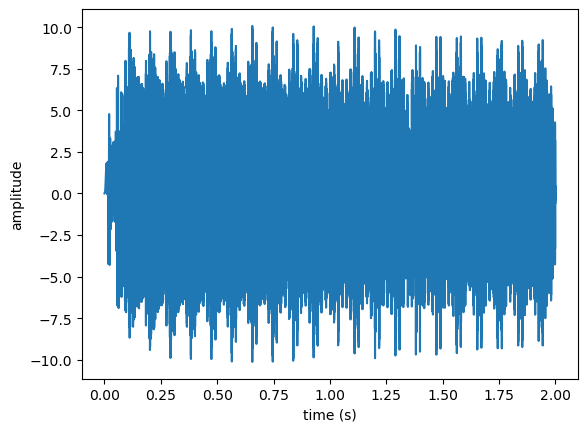

In [98]:
x = np.zeros(3*fs)
x[0] = 1.

schroeder_ir = schroederReverb(chirp)
plt.figure()
plt.plot(np.arange(0,np.size(schroeder_ir))/fs, schroeder_ir)
plt.xlabel('time (s)')
plt.ylabel('amplitude')
plt.show()

In [95]:
Audio(schroeder_ir, rate = fs)

In [104]:
schroeder_ir = schroederReverb(toms_diner)
Audio(schroeder_ir, rate = 44100)

#The result sounds very metallic. I am not satisfied with the reverberator because the metallic effect overshadows the reverb. 

Question 5: Paulson Center noise burst analysis